## Достаём предложения из файлов, находим все пары связанных слов, записываем нужное в словари

Для начала нужно записать данные SynTagRus в удобном виде. Используя библиотеку conllu, обрабатываем предложения и записываем их в виде деревьев.

In [1]:
! pip install conllu  # Устанавливаем пакет для работы с файлами conllu-формата

In [2]:
file_path = "/content/drive/MyDrive/Out_of_the_forest/ru_syntagrus-ud-train-a.conllu"
# Пути к файлам UD SynTagRus (train-a, ниже train-b, train-c, dev, test)

In [3]:
file_b = "/content/drive/MyDrive/Out_of_the_forest/ru_syntagrus-ud-train-b.conllu"

In [4]:
file_c = "/content/drive/MyDrive/Out_of_the_forest/ru_syntagrus-ud-train-c.conllu"

In [5]:
file_dev = "/content/drive/MyDrive/Out_of_the_forest/ru_syntagrus-ud-dev.conllu"

In [6]:
file_test = "/content/drive/MyDrive/Out_of_the_forest/ru_syntagrus-ud-test.conllu"

In [7]:
from conllu import parse_tree

In [8]:
with open(file_path) as my_file:  # Записываем данные из файла в переменную
    data = ''.join(my_file.readlines())

In [9]:
sentences = parse_tree(data)  # Считываем как деревья

In [10]:
example_sent = sentences[68]  # Берём предложение для примера и выводим его деревом
example_sent.print_tree()

(deprel:root) form:попросил lemma:просить upos:VERB [2]
    (deprel:nsubj) form:Он lemma:он upos:PRON [1]
    (deprel:obj) form:Евгению lemma:Евгения upos:PROPN [3]
        (deprel:flat:name) form:Васильевну lemma:Васильевна upos:PROPN [4]
    (deprel:xcomp) form:подождать lemma:подождать upos:VERB [5]
        (deprel:obl) form:недельку lemma:неделька upos:NOUN [7]
            (deprel:obl) form:еще lemma:еще upos:ADV [6]
    (deprel:conj) form:заказал lemma:заказать upos:VERB [15]
        (deprel:cc) form:и lemma:и upos:CCONJ [8]
            (deprel:punct) form:, lemma:, upos:PUNCT [9]
        (deprel:advcl) form:вышла lemma:выйти upos:VERB [13]
            (deprel:mark) form:как lemma:как upos:SCONJ [10]
                (deprel:fixed) form:только lemma:только upos:PART [11]
            (deprel:nsubj) form:она lemma:она upos:PRON [12]
            (deprel:punct) form:, lemma:, upos:PUNCT [14]
        (deprel:obj) form:разговор lemma:разговор upos:NOUN [17]
            (deprel:amod) form

In [11]:
example_sent.children  # Так выводятся потомки корня дерева

[TokenTree<token={id=1, form=Он}, children=None>,
 TokenTree<token={id=3, form=Евгению}, children=[...]>,
 TokenTree<token={id=5, form=подождать}, children=[...]>,
 TokenTree<token={id=15, form=заказал}, children=[...]>,
 TokenTree<token={id=18, form=.}, children=None>]

In [12]:
example_sent.token  # Это сам корень (вершина): его тэги

{'id': 2,
 'form': 'попросил',
 'lemma': 'просить',
 'upos': 'VERB',
 'xpos': None,
 'feats': {'Aspect': 'Perf',
  'Gender': 'Masc',
  'Mood': 'Ind',
  'Number': 'Sing',
  'Tense': 'Past',
  'VerbForm': 'Fin',
  'Voice': 'Act'},
 'head': 0,
 'deprel': 'root',
 'deps': [('root', 0)],
 'misc': None}

In [13]:
example_sent.children[3].print_tree()  # Так выглядят потомки слова с индексом 3

(deprel:conj) form:заказал lemma:заказать upos:VERB [15]
    (deprel:cc) form:и lemma:и upos:CCONJ [8]
        (deprel:punct) form:, lemma:, upos:PUNCT [9]
    (deprel:advcl) form:вышла lemma:выйти upos:VERB [13]
        (deprel:mark) form:как lemma:как upos:SCONJ [10]
            (deprel:fixed) form:только lemma:только upos:PART [11]
        (deprel:nsubj) form:она lemma:она upos:PRON [12]
        (deprel:punct) form:, lemma:, upos:PUNCT [14]
    (deprel:obj) form:разговор lemma:разговор upos:NOUN [17]
        (deprel:amod) form:междугородный lemma:междугородный upos:ADJ [16]


In [14]:
example_sent.children[3].children[2].token

{'id': 17,
 'form': 'разговор',
 'lemma': 'разговор',
 'upos': 'NOUN',
 'xpos': None,
 'feats': {'Animacy': 'Inan',
  'Case': 'Acc',
  'Gender': 'Masc',
  'Number': 'Sing'},
 'head': 15,
 'deprel': 'obj',
 'deps': [('obj', 15)],
 'misc': {'SpaceAfter': 'No'}}

In [15]:
example_sent.children[3].token["lemma"]  # Так можно вывести лемму конкретного слова

'заказать'

In [16]:
example_sent.children[3].children[2].token["lemma"]

'разговор'

In [17]:
example_sent.children[3].children[2].token["deprel"]  # А так -- тип связи этого слова с его родителем

'obj'

In [18]:
example_sent

TokenTree<token={id=2, form=попросил}, children=[...]>

Напишем функцию, записывающую в словарь все дуги дерева: часть речи слова-родителя, часть речи слова-ребёнка, тип связи и количество вхождений, когда ребёнок слева от родителя и когда справа.

In [19]:
def upos_edges_from_sentence(sent, dict1):
  if sent.children:  # Если у слова есть зависимые:
    for child in sent.children:  # Записываем в переменные тэги, отвечающие за части речи, связи и индексы
      upos1 = sent.token["upos"]
      upos2 = child.token["upos"]
      deprel = child.token["deprel"]
      i1 = sent.token["id"]
      i2 = child.token["id"]
      if i1 > i2:  # Если индекс родителя больше
        left = True  # То зависимое слово слева от него
      else:
        left = False

      if upos1 in dict1:  # Если такой ключ уже есть в словаре
        if upos2 in dict1[upos1]:
          if deprel in dict1[upos1][upos2]:
              if left:
                dict1[upos1][upos2][deprel]['left'] += 1  # Просто добавляем 1 к счётчику левых или правых
              else:
                dict1[upos1][upos2][deprel]['right'] += 1
          else:  # Иначе создаём вложенные словари, где будут храниться счётчики "левых" и "правых" случаев (ребёнок слева или справа от родителя)
            dict1[upos1][upos2][deprel] = {}
            if left:
              dict1[upos1][upos2][deprel]['left'] = 1
              dict1[upos1][upos2][deprel]['right'] = 0
            else:
              dict1[upos1][upos2][deprel]['left'] = 0
              dict1[upos1][upos2][deprel]['right'] = 1
        else:
          dict1[upos1][upos2] = {}
          dict1[upos1][upos2][deprel] = {}
          if left:
            dict1[upos1][upos2][deprel]['left'] = 1
            dict1[upos1][upos2][deprel]['right'] = 0
          else:
            dict1[upos1][upos2][deprel]['left'] = 0
            dict1[upos1][upos2][deprel]['right'] = 1
      else:
        dict1[upos1] = {}
        dict1[upos1][upos2] = {}
        dict1[upos1][upos2][deprel] = {}
        if left:
          dict1[upos1][upos2][deprel]['left'] = 1
          dict1[upos1][upos2][deprel]['right'] = 0
        else:
          dict1[upos1][upos2][deprel]['left'] = 0
          dict1[upos1][upos2][deprel]['right'] = 1

      if child.children:  # Рекурсивно вызываем функцию для слов-потомков
        upos_edges_from_sentence(child, dict1)

test_dict1 = {}
upos_edges_from_sentence(example_sent, test_dict1)
test_dict1

{'VERB': {'PRON': {'nsubj': {'left': 2, 'right': 0}},
  'PROPN': {'obj': {'left': 0, 'right': 1}},
  'VERB': {'xcomp': {'left': 0, 'right': 1},
   'conj': {'left': 0, 'right': 1},
   'advcl': {'left': 1, 'right': 0}},
  'NOUN': {'obl': {'left': 0, 'right': 1}, 'obj': {'left': 0, 'right': 1}},
  'CCONJ': {'cc': {'left': 1, 'right': 0}},
  'SCONJ': {'mark': {'left': 1, 'right': 0}},
  'PUNCT': {'punct': {'left': 0, 'right': 2}}},
 'PROPN': {'PROPN': {'flat:name': {'left': 0, 'right': 1}}},
 'NOUN': {'ADV': {'obl': {'left': 1, 'right': 0}},
  'ADJ': {'amod': {'left': 1, 'right': 0}}},
 'CCONJ': {'PUNCT': {'punct': {'left': 0, 'right': 1}}},
 'SCONJ': {'PART': {'fixed': {'left': 0, 'right': 1}}}}

Выше мы записывали только части речи. Напишем такую же функцию, но в качестве ключей словарей первых двух уровней будем брать строку типа "лемма_часть-речи".

In [20]:
def lemma_upos_edges_from_sentence(sent, dict2):
  if sent.children:
    for child in sent.children:
      upos1 = sent.token["upos"]
      upos2 = child.token["upos"]
      deprel = child.token["deprel"]
      lemma1 = sent.token["lemma"]
      lemma2 = child.token["lemma"]
      i1 = sent.token["id"]
      i2 = child.token["id"]
      if i1 > i2:
        left = True
      else:
        left = False
      key1 = f'{lemma1}_{upos1}'
      key2 = f'{lemma2}_{upos2}'

      if key1 in dict2:
        if key2 in dict2[key1]:
          if deprel in dict2[key1][key2]:
              if left:
                dict2[key1][key2][deprel]['left'] += 1
              else:
                dict2[key1][key2][deprel]['right'] += 1
          else:
            dict2[key1][key2][deprel] = {}
            if left:
              dict2[key1][key2][deprel]['left'] = 1
              dict2[key1][key2][deprel]['right'] = 0
            else:
              dict2[key1][key2][deprel]['left'] = 0
              dict2[key1][key2][deprel]['right'] = 1
        else:
          dict2[key1][key2] = {}
          dict2[key1][key2][deprel] = {}
          if left:
            dict2[key1][key2][deprel]['left'] = 1
            dict2[key1][key2][deprel]['right'] = 0
          else:
            dict2[key1][key2][deprel]['left'] = 0
            dict2[key1][key2][deprel]['right'] = 1
      else:
        dict2[key1] = {}
        dict2[key1][key2] = {}
        dict2[key1][key2][deprel] = {}
        if left:
          dict2[key1][key2][deprel]['left'] = 1
          dict2[key1][key2][deprel]['right'] = 0
        else:
          dict2[key1][key2][deprel]['left'] = 0
          dict2[key1][key2][deprel]['right'] = 1

      if child.children:
        lemma_upos_edges_from_sentence(child, dict2)

test_dict2 = {}
lemma_upos_edges_from_sentence(example_sent, test_dict2)
test_dict2

{'просить_VERB': {'он_PRON': {'nsubj': {'left': 1, 'right': 0}},
  'Евгения_PROPN': {'obj': {'left': 0, 'right': 1}},
  'подождать_VERB': {'xcomp': {'left': 0, 'right': 1}},
  'заказать_VERB': {'conj': {'left': 0, 'right': 1}},
  '._PUNCT': {'punct': {'left': 0, 'right': 1}}},
 'Евгения_PROPN': {'Васильевна_PROPN': {'flat:name': {'left': 0, 'right': 1}}},
 'подождать_VERB': {'неделька_NOUN': {'obl': {'left': 0, 'right': 1}}},
 'неделька_NOUN': {'еще_ADV': {'obl': {'left': 1, 'right': 0}}},
 'заказать_VERB': {'и_CCONJ': {'cc': {'left': 1, 'right': 0}},
  'выйти_VERB': {'advcl': {'left': 1, 'right': 0}},
  'разговор_NOUN': {'obj': {'left': 0, 'right': 1}}},
 'и_CCONJ': {',_PUNCT': {'punct': {'left': 0, 'right': 1}}},
 'выйти_VERB': {'как_SCONJ': {'mark': {'left': 1, 'right': 0}},
  'она_PRON': {'nsubj': {'left': 1, 'right': 0}},
  ',_PUNCT': {'punct': {'left': 0, 'right': 1}}},
 'как_SCONJ': {'только_PART': {'fixed': {'left': 0, 'right': 1}}},
 'разговор_NOUN': {'междугородный_ADJ': {'am

Применяем обе функции ко всем предложениям из файлов:

In [21]:
no_lemmas = {}
with_lemmas = {}

for sentence in sentences:
  upos_edges_from_sentence(sentence, no_lemmas)
  lemma_upos_edges_from_sentence(sentence, with_lemmas)

In [22]:
with_lemmas

{'анкета_NOUN': {'._PUNCT': {'punct': {'left': 0, 'right': 1}},
  'и_CCONJ': {'cc': {'left': 2, 'right': 0}},
  'автобиография_NOUN': {'conj': {'left': 0, 'right': 2}},
  'в_ADP': {'case': {'left': 4, 'right': 0}},
  'этот_DET': {'det': {'left': 1, 'right': 0}},
  'заполнять_VERB': {'acl:relcl': {'left': 0, 'right': 1}},
  ',_PUNCT': {'punct': {'left': 0, 'right': 1}},
  'на_ADP': {'case': {'left': 1, 'right': 0}},
  'короткий_ADJ': {'amod': {'left': 1, 'right': 0}},
  'вчера_ADV': {'appos': {'left': 0, 'right': 1}}},
 'человек_NOUN': {'начальник_NOUN': {'nsubj': {'left': 1, 'right': 0}},
  'быть_AUX': {'cop': {'left': 8, 'right': 0}},
  'простой_ADJ': {'amod': {'left': 9, 'right': 2}},
  'приходить_VERB': {'conj': {'left': 0, 'right': 1}},
  'здороваться_VERB': {'conj': {'left': 0, 'right': 1}},
  'писать_VERB': {'conj': {'left': 0, 'right': 1},
   'amod': {'left': 0, 'right': 1}},
  '._PUNCT': {'punct': {'left': 0, 'right': 24}},
  'случайный_ADJ': {'amod': {'left': 2, 'right': 0}},


Добавляем данные всего корпуса:

In [23]:
with open(file_b) as my_file_b:
    data_b = ''.join(my_file_b.readlines())
sentences_b = parse_tree(data_b)

In [24]:
for sentence in sentences_b:
  upos_edges_from_sentence(sentence, no_lemmas)
  lemma_upos_edges_from_sentence(sentence, with_lemmas)

In [25]:
with open(file_c) as my_file_c:
    data_c = ''.join(my_file_c.readlines())
sentences_c = parse_tree(data_c)

In [26]:
for sentence in sentences_c:
  upos_edges_from_sentence(sentence, no_lemmas)
  lemma_upos_edges_from_sentence(sentence, with_lemmas)

In [27]:
with open(file_dev) as my_file_dev:
    data_dev = ''.join(my_file_dev.readlines())
sentences_dev = parse_tree(data_dev)

for sentence in sentences_dev:
  upos_edges_from_sentence(sentence, no_lemmas)
  lemma_upos_edges_from_sentence(sentence, with_lemmas)

In [28]:
with open(file_test) as my_file_test:
    data_test = ''.join(my_file_test.readlines())
sentences_test = parse_tree(data_test)

for sentence in sentences_test:
  upos_edges_from_sentence(sentence, no_lemmas)
  lemma_upos_edges_from_sentence(sentence, with_lemmas)

In [29]:
with_lemmas

{'анкета_NOUN': {'._PUNCT': {'punct': {'left': 0, 'right': 2}},
  'и_CCONJ': {'cc': {'left': 2, 'right': 0}},
  'автобиография_NOUN': {'conj': {'left': 0, 'right': 2}},
  'в_ADP': {'case': {'left': 7, 'right': 0}},
  'этот_DET': {'det': {'left': 1, 'right': 0}},
  'заполнять_VERB': {'acl:relcl': {'left': 0, 'right': 1}},
  ',_PUNCT': {'punct': {'left': 0, 'right': 1}},
  'на_ADP': {'case': {'left': 1, 'right': 0}},
  'короткий_ADJ': {'amod': {'left': 1, 'right': 0}},
  'вчера_ADV': {'appos': {'left': 0, 'right': 1}},
  'опрос_NOUN': {'nmod': {'left': 0, 'right': 1}},
  'Фонд_PROPN': {'nmod': {'left': 0, 'right': 1}},
  '30_NUM': {'nmod': {'left': 0, 'right': 1}},
  'заполнить_VERB': {'acl': {'left': 1, 'right': 0}},
  'специальный_ADJ': {'amod': {'left': 1, 'right': 0}},
  'это_PRON': {'nsubj': {'left': 1, 'right': 0}},
  'быть_AUX': {'cop': {'left': 1, 'right': 0}},
  'конечно_ADV': {'parataxis': {'left': 1, 'right': 0}},
  'скромный_ADJ': {'amod': {'left': 0, 'right': 1}}},
 'человек

Оставляем только значимые данные -- 10 и больше вхождений для словаря с леммами

In [30]:
import copy

meaningful_with_lemmas = copy.deepcopy(with_lemmas)

for a_lemma1 in with_lemmas:
  for a_lemma2 in with_lemmas[a_lemma1]:
    for a_deprel in with_lemmas[a_lemma1][a_lemma2]:
      a_left = with_lemmas[a_lemma1][a_lemma2][a_deprel]['left']
      a_right = with_lemmas[a_lemma1][a_lemma2][a_deprel]['right']
      if a_left + a_right < 10:
        meaningful_with_lemmas[a_lemma1][a_lemma2].pop(a_deprel)

meaningful_with_lemmas

{'анкета_NOUN': {'._PUNCT': {},
  'и_CCONJ': {},
  'автобиография_NOUN': {},
  'в_ADP': {},
  'этот_DET': {},
  'заполнять_VERB': {},
  ',_PUNCT': {},
  'на_ADP': {},
  'короткий_ADJ': {},
  'вчера_ADV': {},
  'опрос_NOUN': {},
  'Фонд_PROPN': {},
  '30_NUM': {},
  'заполнить_VERB': {},
  'специальный_ADJ': {},
  'это_PRON': {},
  'быть_AUX': {},
  'конечно_ADV': {},
  'скромный_ADJ': {}},
 'человек_NOUN': {'начальник_NOUN': {},
  'быть_AUX': {'cop': {'left': 55, 'right': 6}},
  'простой_ADJ': {'amod': {'left': 19, 'right': 4}},
  'приходить_VERB': {},
  'здороваться_VERB': {},
  'писать_VERB': {},
  '._PUNCT': {'punct': {'left': 0, 'right': 133}},
  'случайный_ADJ': {},
  'некурящий_ADJ': {},
  'посторонний_ADJ': {},
  'негодный_ADJ': {},
  'образование_NOUN': {},
  'от_ADP': {'case': {'left': 12, 'right': 0}},
  'вникать_VERB': {},
  'еще_ADV': {},
  'несколько_NUM': {'nummod:gov': {'left': 21, 'right': 0}},
  'этот_DET': {'det': {'left': 120, 'right': 2}},
  'лезть_VERB': {},
  'пят

Очищаем от пустых словарей

In [31]:
# Добавляем только непустые словари

mwl_cleared = {}

for b_lemma1 in meaningful_with_lemmas:
  if len(meaningful_with_lemmas[b_lemma1]) != 0:
    lemma2_dict = {}
    for b_lemma2 in meaningful_with_lemmas[b_lemma1]:
      if len(meaningful_with_lemmas[b_lemma1][b_lemma2]) != 0:
        deprel_dict = {}
        for b_deprel in meaningful_with_lemmas[b_lemma1][b_lemma2]:
          if len(meaningful_with_lemmas[b_lemma1][b_lemma2][b_deprel]) != 0:
            if not 'punct' in b_deprel:
              deprel_dict[b_deprel] = meaningful_with_lemmas[b_lemma1][b_lemma2][b_deprel]
        if deprel_dict != {}:
          lemma2_dict[b_lemma2] = deprel_dict
    if lemma2_dict != {}:
      mwl_cleared[b_lemma1] = lemma2_dict

mwl_cleared

{'человек_NOUN': {'быть_AUX': {'cop': {'left': 55, 'right': 6}},
  'простой_ADJ': {'amod': {'left': 19, 'right': 4}},
  'от_ADP': {'case': {'left': 12, 'right': 0}},
  'несколько_NUM': {'nummod:gov': {'left': 21, 'right': 0}},
  'этот_DET': {'det': {'left': 120, 'right': 2}},
  'на_ADP': {'case': {'left': 71, 'right': 1}},
  'о_ADP': {'case': {'left': 22, 'right': 0}},
  'у_ADP': {'case': {'left': 109, 'right': 0}},
  'и_CCONJ': {'cc': {'left': 67, 'right': 0}},
  'каждый_DET': {'det': {'left': 22, 'right': 0}},
  'не_PART': {'advmod': {'left': 17, 'right': 1}},
  'такой_DET': {'det': {'left': 28, 'right': 5}},
  'конкретный_ADJ': {'amod': {'left': 10, 'right': 0}},
  'с_ADP': {'case': {'left': 93, 'right': 0}},
  'из_ADP': {'case': {'left': 30, 'right': 1}},
  'для_ADP': {'case': {'left': 57, 'right': 0}},
  'живой_ADJ': {'amod': {'left': 11, 'right': 0}},
  'только_PART': {'advmod': {'left': 15, 'right': 0}},
  'миллион_NOUN': {'nummod': {'left': 39, 'right': 0}},
  'к_ADP': {'case':

In [32]:
len(mwl_cleared)

2138

Ура, у нас есть словари со значимыми связями частей речи и слов!

## Word2Vec

Интересно, группируются ли сочетания слов по значениям -- в целом и в зависимости от того, как друг относительно друга расположены слово-родитель и слово-ребёнок?

Для того, чтобы это увидеть, потребуются семантические векторы. Используем готовую модель Word2Vec с сайта RusVectores (ruwikiruscorpora_upos_cbow_300_10_2021) и записываем двойные векторы -- склеенные вектор слова-родителя и вектор слова-потомка.

In [33]:
import gensim
import gensim.downloader
from gensim.models import KeyedVectors

In [34]:
path = '/content/drive/MyDrive/Out_of_the_forest/220/model.bin'
my_model = KeyedVectors.load_word2vec_format(path, binary=True)

In [35]:
# my_model.__getitem__('этот_DET') # KeyError: не всегда совпадают тэги в корпусе и в модели. Придётся брать только те, что совпадают!

In [36]:
import numpy as np

In [37]:
double_vecs = []  # Сюда сохраняем склеенные векторы
list_of_concatenated_lemmas = []  # А сюда -- соответствующие леммы слов

for key1 in mwl_cleared:
    try:
      vec1 = my_model.__getitem__(key1)
      for key2 in mwl_cleared[key1]:
          try:
            vec2 = my_model.__getitem__(key2)
            double_vec = np.concatenate((vec1, vec2), axis=None)
            double_vecs.append(double_vec)
            list_of_concatenated_lemmas.append(f'{key1}-{key2}')
          except:
            pass
    except:
      pass

In [38]:
len(double_vecs)

2382

Для визуализации векторов придётся снизить размерность. В этом поможет UMAP.

In [39]:
!pip install umap-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 4.9 MB/s eta 0:00:00


In [40]:
import umap.umap_ as umap
import seaborn as sns
import matplotlib.pyplot as plt

Пробуем кластеризовать двойные векторы с помощью KMeans:

In [41]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit_predict(double_vecs)
kmeans.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([2, 2, 2, ..., 2, 2, 2], dtype=int32)

In [42]:
reducer = umap.UMAP()
embedding = reducer.fit_transform(double_vecs)
embedding.shape

(2382, 2)

Строим scatter plot:

Text(0.5, 1.0, 'UMAP projection of the double vectors')

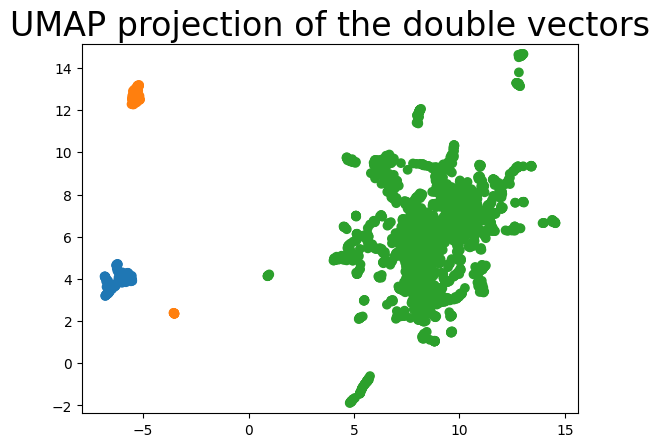

In [43]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=[sns.color_palette()[x] for x in kmeans.labels_])
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the double vectors', fontsize=24)

In [44]:
for num in range(len(kmeans.cluster_centers_)):
  min_pos = np.argmin(np.linalg.norm(double_vecs - kmeans.cluster_centers_[num], axis=1))
  print(min_pos)
  print(list_of_concatenated_lemmas[min_pos])

525
год_NOUN-2000_ADJ
1367
рано_ADV-год_NOUN
410
надо_ADV-конечно_ADV


Теперь давайте посмотрим конкретно на связи прилагательных с существительными:

In [45]:
n_adj_vecs = []
list_of_concatenated_n_adj_lemmas = []

for key1 in mwl_cleared:
  if key1.endswith('NOUN'):
    try:
      vec1 = my_model.__getitem__(key1)
      for key2 in mwl_cleared[key1]:
        if key2.endswith('ADJ'):
          try:
            vec2 = my_model.__getitem__(key2)
            double_vec = np.concatenate((vec1, vec2), axis=None)
            n_adj_vecs.append(double_vec)
            list_of_concatenated_n_adj_lemmas.append(f'{key1}-{key2}')
          except:
            pass
    except:
      pass

In [46]:
len(n_adj_vecs)

840

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Text(0.5, 1.0, 'UMAP projection of the NOUN:ADJ vectors')

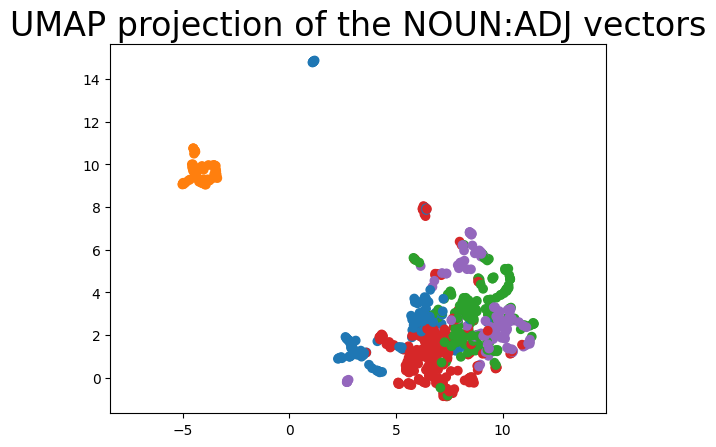

In [47]:
kmeans_n_adj = KMeans(n_clusters=5, random_state=42)
kmeans_n_adj.fit_predict(n_adj_vecs)

embedding_n_adj = reducer.fit_transform(n_adj_vecs)

plt.scatter(
    embedding_n_adj[:, 0],
    embedding_n_adj[:, 1],
    c=[sns.color_palette()[x] for x in kmeans_n_adj.labels_])
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the NOUN:ADJ vectors', fontsize=24)

In [48]:
def print_centroids(kmeans_classifier, vectors, list_of_lemmas):

  for num in range(len(kmeans_classifier.cluster_centers_)):
    min_pos = np.argmin(np.linalg.norm(vectors - kmeans_classifier.cluster_centers_[num], axis=1))
    print(min_pos)
    print(list_of_lemmas[min_pos])


In [49]:
print_centroids(kmeans_n_adj, n_adj_vecs, list_of_concatenated_n_adj_lemmas)

612
усталость_NOUN-хронический_ADJ
155
год_NOUN-1988_ADJ
438
потенциал_NOUN-интеллектуальный_ADJ
587
факт_NOUN-сам_ADJ
675
правительство_NOUN-временный_ADJ


In [50]:
n_adj_vecs_l = []
list_of_concatenated_n_adj_lemmas_l = []
n_adj_vecs_r = []
list_of_concatenated_n_adj_lemmas_r = []

for key1 in with_lemmas:
  if key1.endswith('NOUN'):
    try:
      vec1 = my_model.__getitem__(key1)
      for key2 in with_lemmas[key1]:
        if key2.endswith('ADJ'):
          try:
            vec2 = my_model.__getitem__(key2)
            double_vec = np.concatenate((vec1, vec2), axis=None)
            for key3 in with_lemmas[key1][key2]:
              if with_lemmas[key1][key2][key3]['left'] > with_lemmas[key1][key2][key3]['right']:
                n_adj_vecs_l.append(double_vec)
                list_of_concatenated_n_adj_lemmas_l.append(f'{key1}-{key2}-{key3}')
              else:
                n_adj_vecs_r.append(double_vec)
                list_of_concatenated_n_adj_lemmas_r.append(f'{key1}-{key2}-{key3}')
          except:
            pass
    except:
      pass

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Text(0.5, 1.0, 'UMAP projection of the NOUN<ADJ (right) vectors')

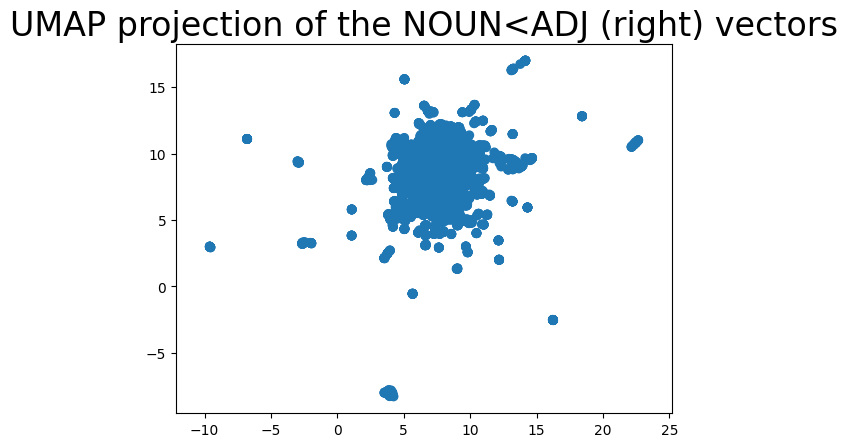

In [51]:
kmeans_n_adj_r = KMeans(n_clusters=1, random_state=42)
kmeans_n_adj_r.fit_predict(n_adj_vecs_r)

embedding_n_adj_r = reducer.fit_transform(n_adj_vecs_r)

plt.scatter(
    embedding_n_adj_r[:, 0],
    embedding_n_adj_r[:, 1],
    c=[sns.color_palette()[x] for x in kmeans_n_adj_r.labels_])
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the NOUN<ADJ (right) vectors', fontsize=24)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:274: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


Text(0.5, 1.0, 'UMAP projection of the NOUN>ADJ (left) vectors')

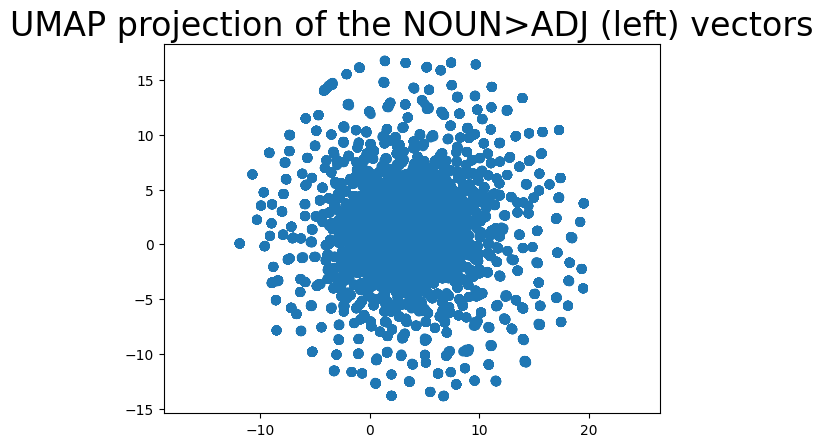

In [52]:
kmeans_n_adj_l = KMeans(n_clusters=1, random_state=42)
kmeans_n_adj_l.fit_predict(n_adj_vecs_l)

embedding_n_adj_l = reducer.fit_transform(n_adj_vecs_l)

plt.scatter(
    embedding_n_adj_l[:, 0],
    embedding_n_adj_l[:, 1],
    c=[sns.color_palette()[x] for x in kmeans_n_adj_l.labels_])
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the NOUN>ADJ (left) vectors', fontsize=24)

## Пишу всё в виде функций, чтобы удобно было запускать с разными вводными

In [53]:
def edge2vec(pos1, pos2, double_vectors, concat_lemmas):

  for key1 in mwl_cleared:
    if key1.endswith(str(pos1)):
      try:
        vec1 = my_model.__getitem__(key1)
        for key2 in mwl_cleared[key1]:
          if key2.endswith(str(pos2)):
            try:
              vec2 = my_model.__getitem__(key2)
              double_vec = np.concatenate((vec1, vec2), axis=None)
              double_vectors.append(double_vec)
              concat_lemmas.append(f'{key1}-{key2}')
            except:
              pass
      except:
        pass

    return concat_lemmas, double_vectors

In [54]:
# double_vectors_v_n = []
# concat_lemmas_v_n = []

# for key1 in mwl_cleared:
#     if key1.endswith('VERB'):
#       try:
#         vec1 = my_model.__getitem__(key1)
#         for key2 in mwl_cleared[key1]:
#           if key2.endswith('NOUN'):
#             try:
#               vec2 = my_model.__getitem__(key2)
#               double_vec = np.concatenate((vec1, vec2), axis=None)
#               double_vectors_v_n.append(double_vec)
#               concat_lemmas_v_n.append(f'{key1}-{key2}')
#             except:
#               pass
#       except:
#         pass

In [55]:
this_edge2vec = edge2vec('NOUN', 'ADJ', [], [])
this_edge2vec[0]

['человек_NOUN-простой_ADJ',
 'человек_NOUN-конкретный_ADJ',
 'человек_NOUN-живой_ADJ',
 'человек_NOUN-молодой_ADJ',
 'человек_NOUN-пожилой_ADJ',
 'человек_NOUN-образованный_ADJ',
 'человек_NOUN-разный_ADJ',
 'человек_NOUN-обычный_ADJ',
 'человек_NOUN-здоровый_ADJ',
 'человек_NOUN-серьезный_ADJ',
 'человек_NOUN-другой_ADJ',
 'человек_NOUN-советский_ADJ',
 'человек_NOUN-умный_ADJ',
 'человек_NOUN-порядочный_ADJ',
 'человек_NOUN-нормальный_ADJ',
 'человек_NOUN-хороший_ADJ',
 'человек_NOUN-добрый_ADJ']

In [56]:
def cluster_vecs_and_show_centroids(num_clusters, upos1, upos2, double_vectors, concat_lemmas):

  kmeans_classifier = KMeans(n_clusters=num_clusters, random_state=42)
  kmeans_classifier.fit_predict(double_vectors)

  embedding = reducer.fit_transform(double_vectors)

  plt.scatter(
      embedding[:, 0],
      embedding[:, 1],
      c=[sns.color_palette()[x] for x in kmeans_classifier.labels_])
  plt.gca().set_aspect('equal', 'datalim')
  plt.title(f'UMAP projection of the {upos1} - {upos2} vectors', fontsize=24)

  print_centroids(kmeans_classifier, double_vectors, concat_lemmas)

In [57]:
# cluster_vecs_and_show_centroids(2, 'VERB', 'NOUN', double_vectors_v_n, concat_lemmas_v_n)

In [58]:
def show_me_clustering_and_centroids_of(upos1, upos2, num_clusters):
  this_edge2vec = edge2vec(upos1, upos2, [], [])
  cluster_vecs_and_show_centroids(num_clusters, upos1, upos2, this_edge2vec[1], this_edge2vec[0])

## Теперь тестирую на разных сочетаниях частей речи

In [59]:
adv_adv_vecs = []
list_of_concatenated_adv_adv_lemmas = []

for key1 in mwl_cleared:
  if key1.endswith('ADV'):
    try:
      vec1 = my_model.__getitem__(key1)
      for key2 in mwl_cleared[key1]:
        if key2.endswith('ADV'):
          try:
            vec2 = my_model.__getitem__(key2)
            double_vec = np.concatenate((vec1, vec2), axis=None)
            adv_adv_vecs.append(double_vec)
            list_of_concatenated_adv_adv_lemmas.append(f'{key1}-{key2}')
          except:
            pass
    except:
      pass

list_of_concatenated_adv_adv_lemmas

['можно_ADV-вполне_ADV',
 'можно_ADV-теперь_ADV',
 'можно_ADV-можно_ADV',
 'можно_ADV-например_ADV',
 'можно_ADV-сегодня_ADV',
 'можно_ADV-так_ADV',
 'можно_ADV-конечно_ADV',
 'можно_ADV-сейчас_ADV',
 'можно_ADV-всегда_ADV',
 'можно_ADV-где_ADV',
 'можно_ADV-уже_ADV',
 'можно_ADV-как_ADV',
 'можно_ADV-поэтому_ADV',
 'можно_ADV-тут_ADV',
 'так_ADV-далее_ADV',
 'так_ADV-примерно_ADV',
 'так_ADV-иначе_ADV',
 'так_ADV-точно_ADV',
 'так_ADV-совсем_ADV',
 'потому_ADV-потому_ADV',
 'как_ADV-можно_ADV',
 'надо_ADV-конечно_ADV',
 'надо_ADV-так_ADV',
 'надо_ADV-надо_ADV',
 'надо_ADV-поэтому_ADV',
 'более_ADV-менее_ADV',
 'более_ADV-гораздо_ADV',
 'более_ADV-еще_ADV',
 'более_ADV-куда_ADV',
 'более_ADV-уже_ADV',
 'там_ADV-где_ADV',
 'нельзя_ADV-никак_ADV',
 'больше_ADV-еще_ADV',
 'больше_ADV-гораздо_ADV',
 'как-то_ADV-хоть_ADV',
 'много_ADV-как_ADV',
 'много_ADV-слишком_ADV',
 'много_ADV-очень_ADV',
 'много_ADV-еще_ADV',
 'много_ADV-так_ADV',
 'сильно_ADV-очень_ADV',
 'хорошо_ADV-очень_ADV',
 'хо

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


19
потому_ADV-потому_ADV
6
можно_ADV-конечно_ADV


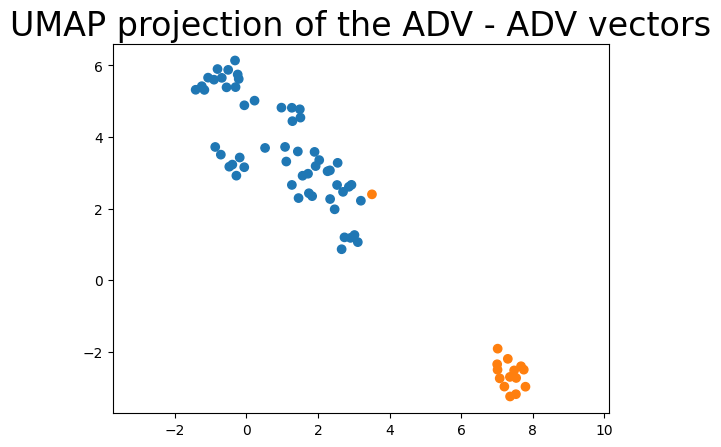

In [60]:
cluster_vecs_and_show_centroids(2, 'ADV', 'ADV', adv_adv_vecs, list_of_concatenated_adv_adv_lemmas)

In [61]:
adv_adv_vecs_l = []
list_of_concatenated_adv_adv_lemmas_l = []
adv_adv_vecs_r = []
list_of_concatenated_adv_adv_lemmas_r = []

for key1 in with_lemmas:
  if key1.endswith('ADV'):
    try:
      vec1 = my_model.__getitem__(key1)
      for key2 in with_lemmas[key1]:
        if key2.endswith('ADV'):
          try:
            vec2 = my_model.__getitem__(key2)
            double_vec = np.concatenate((vec1, vec2), axis=None)
            for key3 in with_lemmas[key1][key2]:
              if with_lemmas[key1][key2][key3]['left'] > with_lemmas[key1][key2][key3]['right']:
                adv_adv_vecs_l.append(double_vec)
                list_of_concatenated_adv_adv_lemmas_l.append(f'{key1}-{key2}-{key3}')
              else:
                adv_adv_vecs_r.append(double_vec)
                list_of_concatenated_adv_adv_lemmas_r.append(f'{key1}-{key2}-{key3}')
          except:
            pass
    except:
      pass

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Text(0.5, 1.0, 'UMAP projection of the ADV<ADV (right) vectors')

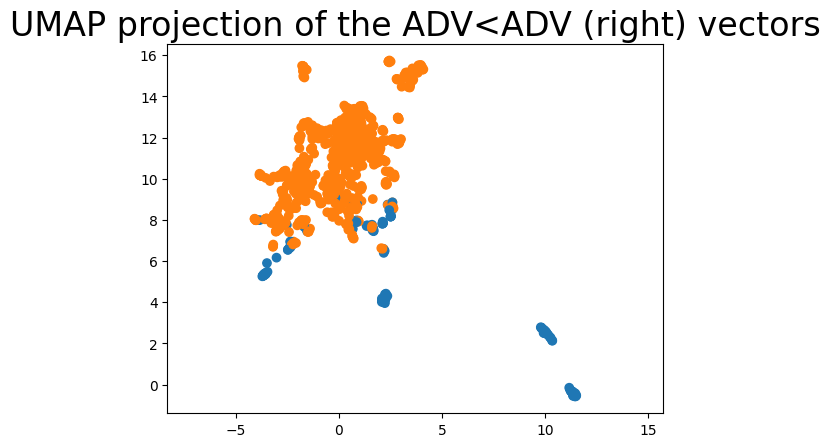

In [62]:
kmeans_adv_adv_r = KMeans(n_clusters=2, random_state=42)
kmeans_adv_adv_r.fit_predict(adv_adv_vecs_r)

embedding_adv_adv_r = reducer.fit_transform(adv_adv_vecs_r)

plt.scatter(
    embedding_adv_adv_r[:, 0],
    embedding_adv_adv_r[:, 1],
    c=[sns.color_palette()[x] for x in kmeans_adv_adv_r.labels_])
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the ADV<ADV (right) vectors', fontsize=24)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Text(0.5, 1.0, 'UMAP projection of the ADV>ADV (left) vectors')

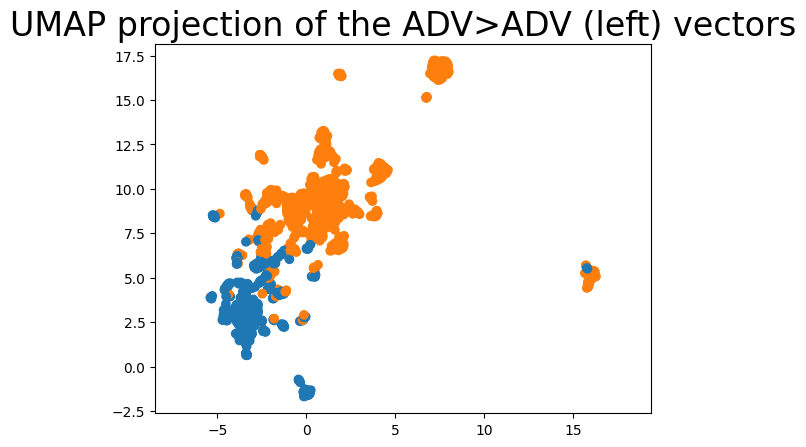

In [63]:
kmeans_adv_adv_l = KMeans(n_clusters=2, random_state=42)
kmeans_adv_adv_l.fit_predict(adv_adv_vecs_l)

embedding_adv_adv_l = reducer.fit_transform(adv_adv_vecs_l)

plt.scatter(
    embedding_adv_adv_l[:, 0],
    embedding_adv_adv_l[:, 1],
    c=[sns.color_palette()[x] for x in kmeans_adv_adv_l.labels_])
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the ADV>ADV (left) vectors', fontsize=24)